# Analyse et prédiction des crimes dans la ville de New-York en utilisant une approche  d'apprentissage automatique et des données spatiotemporelles 


## Importing Data : 

In [2]:
import pandas as pd 
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
data = pd.read_csv('/content/drive/MyDrive/NYPD_Complaint_Data_Historic.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (18,20) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


# Explore Data :

In [ ]:
data.sample(5)

,CMPLNT_NUM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,ADDR_PCT_CD,RPT_DT,KY_CD,OFNS_DESC,PD_CD,PD_DESC,CRM_ATPT_CPTD_CD,LAW_CAT_CD,BORO_NM,LOC_OF_OCCUR_DESC,PREM_TYP_DESC,JURIS_DESC,JURISDICTION_CODE,PARKS_NM,HADEVELOPT,HOUSING_PSA,X_COORD_CD,Y_COORD_CD,SUSP_AGE_GROUP,SUSP_RACE,SUSP_SEX,TRANSIT_DISTRICT,Latitude,Longitude,Lat_Lon,PATROL_BORO,STATION_NAME,VIC_AGE_GROUP,VIC_RACE,VIC_SEX
6019227,381059887,10/18/2012,13:40:00,10/18/2012,13:56:00,45.0,10/18/2012,341,PETIT LARCENY,333.0,"LARCENY,PETIT FROM STORE-SHOPL",COMPLETED,MISDEMEANOR,BRONX,INSIDE,DEPARTMENT STORE,N.Y. POLICE DEPT,0.0,NaN,NaN,NaN,1033597.0,255731.0,NaN,NaN,NaN,NaN,40.868467,-73.821583,"(40.868467378, -73.821582846)",PATROL BORO BRONX,NaN,NaN,UNKNOWN,D
222809,623098316,06/14/2016,17:15:00,06/14/2016,17:20:00,14.0,06/14/2016,341,PETIT LARCENY,333.0,"LARCENY,PETIT FROM STORE-SHOPL",COMPLETED,MISDEMEANOR,MANHATTAN,INSIDE,CLOTHING/BOUTIQUE,N.Y. POLICE DEPT,0.0,NaN,NaN,NaN,988058.0,214775.0,NaN,NaN,NaN,NaN,40.756192,-73.986256,"(40.75619167, -73.986256492)",PATROL BORO MAN SOUTH,NaN,UNKNOWN,UNKNOWN,D
1396058,876583338,12/24/2008,22:00:00,01/08/2009,16:00:00,9.0,01/08/2009,341,PETIT LARCENY,321.0,"LARCENY,PETIT FROM AUTO",COMPLETED,MISDEMEANOR,MANHATTAN,NaN,STREET,N.Y. POLICE DEPT,0.0,NaN,NaN,NaN,986179.0,203578.0,NaN,NaN,NaN,NaN,40.725459,-73.993042,"(40.725459295, -73.993041942)",PATROL BORO MAN SOUTH,NaN,25-44,WHITE,M
6595480,482168896,07/31/2013,23:00:00,07/31/2013,23:05:00,48.0,08/01/2013,105,ROBBERY,386.0,"ROBBERY,PERSONAL ELECTRONIC DEVICE",COMPLETED,FELONY,BRONX,FRONT OF,STREET,N.Y. POLICE DEPT,0.0,NaN,NaN,NaN,1018947.0,245282.0,<18,BLACK,M,NaN,40.839858,-73.874605,"(40.83985775, -73.874605258)",PATROL BORO BRONX,NaN,<18,BLACK,M
5339707,143904998,06/11/2016,15:30:00,06/11/2016,16:00:00,67.0,06/11/2016,578,HARRASSMENT 2,637.0,"HARASSMENT,SUBD 1,CIVILIAN",COMPLETED,VIOLATION,BROOKLYN,INSIDE,RESIDENCE-HOUSE,N.Y. POLICE DEPT,0.0,NaN,NaN,NaN,1006712.0,176818.0,25-44,BLACK,M,NaN,40.651981,-73.919052,"(40.651980959, -73.919051596)",PATROL BORO BKLYN SOUTH,NaN,65+,BLACK,F


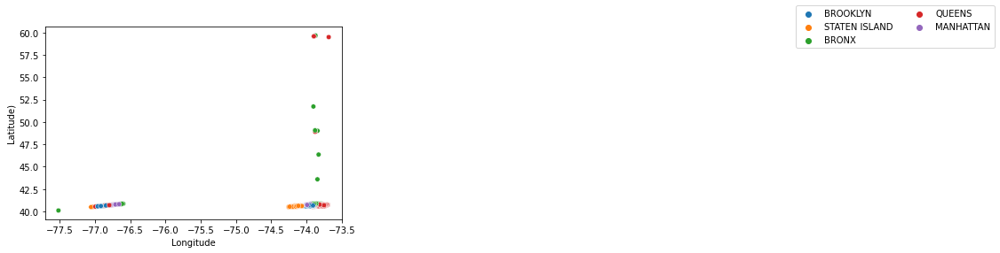

In [ ]:
# Visualization: map of accidents by County
import matplotlib.pyplot as plt 
import seaborn as sns
g = sns.scatterplot(x='Longitude', y='Latitude', data=data, hue='BORO_NM', s=30)
plt.xlabel('Longitude')
plt.ylabel('Latitude)')
g.legend(loc='center left', bbox_to_anchor=(2.51, 1), ncol=2)
plt.show()

Heatmap for `BROOKLYN`

In [10]:
import plotly.express as px
df = data[(data['BORO_NM']=='BROOKLYN')]
df_data = df[(df['OFNS_DESC'] == 'HARRASSMENT 2')]

fig = px.density_mapbox(df_data, lat='Latitude', lon='Longitude', radius=5, zoom=7,
                        color_continuous_scale=px.colors.sequential.YlOrRd,
                        mapbox_style="stamen-terrain")
fig.update_layout(
        title = 'New York - BROOKLYN',
)
fig.show()

Heat Map of MANHATTAN

In [13]:
import plotly.express as px
df = data[(data['BORO_NM']=='MANHATTAN')]
df_data = df[(df['OFNS_DESC'] == 'HARRASSMENT 2')]

fig = px.density_mapbox(df_data, lat='Latitude', lon='Longitude', radius=5, zoom=7,
                        color_continuous_scale=px.colors.sequential.YlOrRd,
                        mapbox_style="stamen-terrain")
fig.update_layout(
        title = 'New York - MANHATTAN',
)
fig.show()

In [3]:
!pip install folium

In [4]:
import folium
import folium.plugins as plugins
from folium.plugins import HeatMapWithTime
from folium.plugins import HeatMap

In [5]:
#first, copy all data [all 2017 county accidents] to our map dataframe
df_map = data.copy()
df_map['count']=1
df_map[['Latitude', 'Longitude', 'count']].groupby(['Latitude', 'Longitude']).sum().sort_values('count', ascending=False).head(10)

df_map.shape

(6983207, 36)

In [6]:
def generateBaseMap(default_location=[40.5397293,-74.6273494], default_zoom_start=12):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map

base_map = generateBaseMap()
m = HeatMap(data=df_map[['Latitude', 'Longitude', 'count']].groupby(['Latitude','Longitude']).sum().reset_index().values.tolist(), radius=7, max_zoom=10).add_to(base_map)
base_map.save('./heatmap.html')

In [7]:
base_map

In [14]:
# Check the beginning and end date of this dataset
data['CMPLNT_FR_TM'] = pd.to_datetime(data['CMPLNT_FR_TM'], errors='coerce')

print('This dataset contains data beween {} and {}.'.format(data.CMPLNT_FR_TM.min(),data.CMPLNT_FR_TM.max()))

This dataset contains data beween 2021-12-30 00:00:00 and 2021-12-30 23:59:00.


In [4]:
#Convert Start_Time and End_Time to datetypes
data['CMPLNT_FR_DT'] = pd.to_datetime(data['CMPLNT_FR_DT'], errors='coerce')
data['CMPLNT_TO_DT'] = pd.to_datetime(data['CMPLNT_TO_DT'], errors='coerce')
#data['CMPLNT_FR_TM'] = pd.to_datetime(data['CMPLNT_FR_TM'], errors='coerce')
#data['CMPLNT_TO_TM'] = pd.to_datetime(data['CMPLNT_FR_TM'], errors='coerce')
data['RPT_DT'] = pd.to_datetime(data['RPT_DT'], errors='coerce')

In [ ]:
data['CMPLNT_FR_TM'].dtype 

dtype('O')

In [5]:
# Extract year, month, day, hour and weekday
data['Year']=data['CMPLNT_FR_DT'].dt.year
data['Month']=data['CMPLNT_FR_DT'].dt.strftime('%b')
data['Day']=data['CMPLNT_FR_DT'].dt.day
data['Hour']=data['CMPLNT_FR_DT'].dt.hour
data['Weekday']=data['CMPLNT_FR_DT'].dt.strftime('%a')

In [31]:
data['CMPLNT_FR_TM'] = pd.to_datetime(data['CMPLNT_FR_TM'], errors='coerce')
data['Hour']=data['CMPLNT_FR_TM'].dt.hour

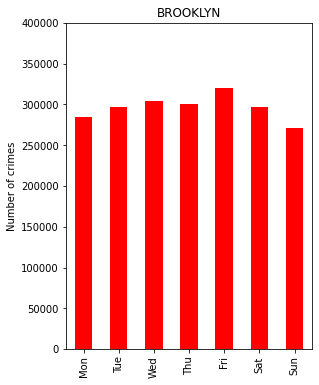

In [17]:
# Hourly distribution of accidents on weekdays in NY (for the whole dataset)
# Set the size of the figure
import matplotlib.pyplot as plt 
state_lst=['BROOKLYN']
weekday_lst = [ 'Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']
# Set a list of colors, markers and linestyles for plotting
color_lst=['r']
marker_lst=['*']
linestyle_lst=['dashed']
fig= plt.figure(figsize=(15,6))

for i,state in enumerate(state_lst):
    plt.subplot(1, 3, 1+i)
    data[data['BORO_NM']==state].groupby('Weekday').count()['CMPLNT_NUM'].reindex(weekday_lst).plot(kind='bar',color=color_lst[i]).set_title(state)
    plt.xlabel('')
    plt.ylim(0, 400000)
    
    # Only diplay ylabel on the leftmost plot
    if i==0:
        plt.ylabel('Number of crimes')

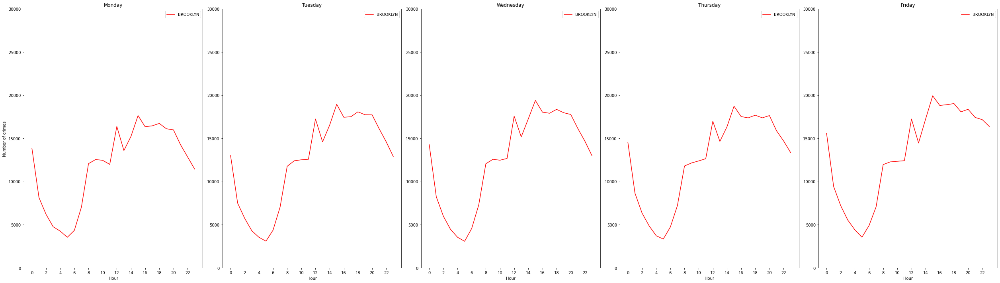

In [32]:
# Hourly distribution of accidents on weekdays in NY
# Set the size of the figure
import numpy as np
weekday_lst_full = [ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
fig= plt.figure(figsize=(35,10))
hour_lst= np.arange(24)
n=5

# Make subplots on each weekday with a for loop
for i in range(n):
    plt.subplot(1, 5, i+1)
   
    # Plot the state of New York on weekdays, group the data by hours and count the number of accident, reorder the data by hours, make lineplot with certain style and color
    data[(data['BORO_NM']=='BROOKLYN') & (data['Weekday']==weekday_lst[i])].groupby('Hour').count()['CMPLNT_NUM'].reindex(hour_lst).plot(linestyle='solid',color='r')
    
    # Set labels, limit, legend, title and xticks
    plt.xlabel('Hour')
    plt.ylim(0, 30000)
    plt.legend(['BROOKLYN'])
    plt.title(weekday_lst_full[i])
    plt.xticks(np.arange(0, 24, step=2))
    
    # Only diplay ylabel on the leftmost plot
    if i==0:
        plt.ylabel('Number of crimes')

plt.tight_layout()
plt.show()

# Clean Data :

In [19]:
# compute missing values :
data.isnull().sum()
for column in data.columns :
  if (data[column].isnull().sum() > (len(data)/2)): 
    print(column , data[column].isnull().sum())

PARKS_NM 6958159
HADEVELOPT 6637179
HOUSING_PSA 6446298
SUSP_AGE_GROUP 4707573
TRANSIT_DISTRICT 6826123
STATION_NAME 6826123


In [20]:
# as seen below features [PARKS_NM , HADEVELOPT , HOUSING_PSA , TRANSIT_DISTRICT ,STATION_NAME]
# are almost null values so it's better to delete them 
data = data.drop(['PARKS_NM' , 'HADEVELOPT' , 'HOUSING_PSA' , 'TRANSIT_DISTRICT' ,'STATION_NAME'], axis =1)

In [21]:
len(data.columns)

35

In [22]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6983207 entries, 0 to 6983206
Data columns (total 35 columns):
 #   Column             Dtype         
---  ------             -----         
 0   CMPLNT_NUM         int64         
 1   CMPLNT_FR_DT       datetime64[ns]
 2   CMPLNT_FR_TM       datetime64[ns]
 3   CMPLNT_TO_DT       datetime64[ns]
 4   CMPLNT_TO_TM       object        
 5   ADDR_PCT_CD        float64       
 6   RPT_DT             datetime64[ns]
 7   KY_CD              int64         
 8   OFNS_DESC          object        
 9   PD_CD              float64       
 10  PD_DESC            object        
 11  CRM_ATPT_CPTD_CD   object        
 12  LAW_CAT_CD         object        
 13  BORO_NM            object        
 14  LOC_OF_OCCUR_DESC  object        
 15  PREM_TYP_DESC      object        
 16  JURIS_DESC         object        
 17  JURISDICTION_CODE  float64       
 18  X_COORD_CD         float64       
 19  Y_COORD_CD         float64       
 20  SUSP_AGE_GROUP     objec

In [ ]:

print(data['CMPLNT_FR_DT'].isnull().sum(), data['CMPLNT_TO_DT'].isnull().sum())


810 1668379


In [6]:
#We will keep just relevant  features:
data.columns
relevant_features= ['CMPLNT_FR_TM','CMPLNT_TO_TM','Year', 'Month', 'Day','Hour','Weekday','LAW_CAT_CD','PREM_TYP_DESC','ADDR_PCT_CD','KY_CD','BORO_NM','ADDR_PCT_CD','Latitude', 'Longitude','VIC_AGE_GROUP',
        'VIC_SEX','CRM_ATPT_CPTD_CD','SUSP_AGE_GROUP', 'SUSP_SEX','OFNS_DESC']
data_final = data[relevant_features]
data_final

,CMPLNT_FR_TM,CMPLNT_TO_TM,Year,Month,Day,Hour,Weekday,LAW_CAT_CD,PREM_TYP_DESC,ADDR_PCT_CD,KY_CD,BORO_NM,ADDR_PCT_CD,Latitude,Longitude,VIC_AGE_GROUP,VIC_SEX,CRM_ATPT_CPTD_CD,SUSP_AGE_GROUP,SUSP_SEX,OFNS_DESC
0,17:25:00,17:35:00,2014.0,Sep,4.0,0.0,Thu,MISDEMEANOR,STREET,81.0,344,BROOKLYN,81.0,40.685041,-73.921777,25-44,F,COMPLETED,NaN,NaN,ASSAULT 3 & RELATED OFFENSES
1,07:40:00,07:45:00,2016.0,Oct,12.0,0.0,Wed,FELONY,STREET,121.0,109,STATEN ISLAND,121.0,40.636991,-74.134093,45-64,F,COMPLETED,UNKNOWN,U,GRAND LARCENY
2,13:30:00,14:00:00,2012.0,Sep,28.0,0.0,Fri,FELONY,STREET,41.0,109,BRONX,41.0,40.823876,-73.891863,45-64,F,COMPLETED,NaN,M,GRAND LARCENY
3,15:45:00,NaN,2015.0,Mar,24.0,0.0,Tue,MISDEMEANOR,STREET,46.0,341,BRONX,46.0,40.845707,-73.910398,<18,F,COMPLETED,NaN,M,PETIT LARCENY
4,04:02:00,04:09:00,2017.0,May,20.0,0.0,Sat,MISDEMEANOR,STREET,109.0,344,QUEENS,109.0,40.763992,-73.828426,25-44,M,COMPLETED,25-44,M,ASSAULT 3 & RELATED OFFENSES
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6983202,17:50:00,17:55:00,2014.0,Sep,12.0,0.0,Fri,MISDEMEANOR,COMMERCIAL BUILDING,28.0,341,MANHATTAN,28.0,40.808374,-73.946886,NaN,D,COMPLETED,NaN,NaN,PETIT LARCENY
6983203,13:30:00,13:35:00,2012.0,Dec,20.0,0.0,Thu,MISDEMEANOR,STREET,70.0,344,BROOKLYN,70.0,40.648648,-73.967731,25-44,F,COMPLETED,NaN,NaN,ASSAULT 3 & RELATED OFFENSES
6983204,13:00:00,15:30:00,2013.0,Apr,4.0,0.0,Thu,MISDEMEANOR,STREET,90.0,341,BROOKLYN,90.0,40.716045,-73.964163,45-64,M,COMPLETED,NaN,NaN,PETIT LARCENY
6983205,13:00:00,13:50:00,2015.0,Sep,9.0,0.0,Wed,MISDEMEANOR,TRANSIT - NYC SUBWAY,13.0,360,MANHATTAN,13.0,40.735211,-73.991691,NaN,E,COMPLETED,NaN,NaN,NaN


In [24]:
data_final = data_final.drop_duplicates()

In [25]:
data_final.shape

(6920132, 21)

In [ ]:
# Check missing values
data_final.isnull().mean()

CMPLNT_FR_TM        0.000007
CMPLNT_TO_TM        0.238143
Year                0.000114
Month               0.000114
Day                 0.000114
Hour                0.000114
Weekday             0.000114
LAW_CAT_CD          0.000000
PREM_TYP_DESC       0.005681
ADDR_PCT_CD         0.000309
KY_CD               0.000000
BORO_NM             0.001547
ADDR_PCT_CD         0.000309
Latitude            0.003457
Longitude           0.003457
VIC_AGE_GROUP       0.233389
VIC_SEX             0.000044
CRM_ATPT_CPTD_CD    0.000001
SUSP_AGE_GROUP      0.673962
SUSP_SEX            0.496017
OFNS_DESC           0.002694
dtype: float64

In [7]:
import numpy as np
import pandas as pd
data_final['CMPLNT_FR_TM'] = pd.to_datetime(data_final['CMPLNT_FR_TM'], errors='coerce')
data_final['CMPLNT_TO_TM'] = pd.to_datetime(data_final['CMPLNT_TO_TM'], errors='coerce')
td='Time_Duration(min)'
data_final[td]=(data_final['CMPLNT_TO_TM']- data_final['CMPLNT_FR_TM'])/np.timedelta64(1,'m')
data_final.info()
data_final.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6983207 entries, 0 to 6983206
Data columns (total 22 columns):
 #   Column              Dtype         
---  ------              -----         
 0   CMPLNT_FR_TM        datetime64[ns]
 1   CMPLNT_TO_TM        datetime64[ns]
 2   Year                float64       
 3   Month               object        
 4   Day                 float64       
 5   Hour                float64       
 6   Weekday             object        
 7   LAW_CAT_CD          object        
 8   PREM_TYP_DESC       object        
 9   ADDR_PCT_CD         float64       
 10  KY_CD               int64         
 11  BORO_NM             object        
 12  ADDR_PCT_CD         float64       
 13  Latitude            float64       
 14  Longitude           float64       
 15  VIC_AGE_GROUP       object        
 16  VIC_SEX             object        
 17  CRM_ATPT_CPTD_CD    object        
 18  SUSP_AGE_GROUP      object        
 19  SUSP_SEX            object        
 20  OF

,CMPLNT_FR_TM,CMPLNT_TO_TM,Year,Month,Day,Hour,Weekday,LAW_CAT_CD,PREM_TYP_DESC,ADDR_PCT_CD,KY_CD,BORO_NM,ADDR_PCT_CD,Latitude,Longitude,VIC_AGE_GROUP,VIC_SEX,CRM_ATPT_CPTD_CD,SUSP_AGE_GROUP,SUSP_SEX,OFNS_DESC,Time_Duration(min)
0,2021-12-30 17:25:00,2021-12-30 17:35:00,2014.0,Sep,4.0,0.0,Thu,MISDEMEANOR,STREET,81.0,344,BROOKLYN,81.0,40.685041,-73.921777,25-44,F,COMPLETED,NaN,NaN,ASSAULT 3 & RELATED OFFENSES,10.0
1,2021-12-30 07:40:00,2021-12-30 07:45:00,2016.0,Oct,12.0,0.0,Wed,FELONY,STREET,121.0,109,STATEN ISLAND,121.0,40.636991,-74.134093,45-64,F,COMPLETED,UNKNOWN,U,GRAND LARCENY,5.0
2,2021-12-30 13:30:00,2021-12-30 14:00:00,2012.0,Sep,28.0,0.0,Fri,FELONY,STREET,41.0,109,BRONX,41.0,40.823876,-73.891863,45-64,F,COMPLETED,NaN,M,GRAND LARCENY,30.0
3,2021-12-30 15:45:00,NaT,2015.0,Mar,24.0,0.0,Tue,MISDEMEANOR,STREET,46.0,341,BRONX,46.0,40.845707,-73.910398,<18,F,COMPLETED,NaN,M,PETIT LARCENY,NaN
4,2021-12-30 04:02:00,2021-12-30 04:09:00,2017.0,May,20.0,0.0,Sat,MISDEMEANOR,STREET,109.0,344,QUEENS,109.0,40.763992,-73.828426,25-44,M,COMPLETED,25-44,M,ASSAULT 3 & RELATED OFFENSES,7.0


In [8]:
data_final['Hour']=data_final['CMPLNT_FR_TM'].dt.hour

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [9]:
data_final

,CMPLNT_FR_TM,CMPLNT_TO_TM,Year,Month,Day,Hour,Weekday,LAW_CAT_CD,PREM_TYP_DESC,ADDR_PCT_CD,KY_CD,BORO_NM,ADDR_PCT_CD,Latitude,Longitude,VIC_AGE_GROUP,VIC_SEX,CRM_ATPT_CPTD_CD,SUSP_AGE_GROUP,SUSP_SEX,OFNS_DESC,Time_Duration(min)
0,2021-12-30 17:25:00,2021-12-30 17:35:00,2014.0,Sep,4.0,17.0,Thu,MISDEMEANOR,STREET,81.0,344,BROOKLYN,81.0,40.685041,-73.921777,25-44,F,COMPLETED,NaN,NaN,ASSAULT 3 & RELATED OFFENSES,10.0
1,2021-12-30 07:40:00,2021-12-30 07:45:00,2016.0,Oct,12.0,7.0,Wed,FELONY,STREET,121.0,109,STATEN ISLAND,121.0,40.636991,-74.134093,45-64,F,COMPLETED,UNKNOWN,U,GRAND LARCENY,5.0
2,2021-12-30 13:30:00,2021-12-30 14:00:00,2012.0,Sep,28.0,13.0,Fri,FELONY,STREET,41.0,109,BRONX,41.0,40.823876,-73.891863,45-64,F,COMPLETED,NaN,M,GRAND LARCENY,30.0
3,2021-12-30 15:45:00,NaT,2015.0,Mar,24.0,15.0,Tue,MISDEMEANOR,STREET,46.0,341,BRONX,46.0,40.845707,-73.910398,<18,F,COMPLETED,NaN,M,PETIT LARCENY,NaN
4,2021-12-30 04:02:00,2021-12-30 04:09:00,2017.0,May,20.0,4.0,Sat,MISDEMEANOR,STREET,109.0,344,QUEENS,109.0,40.763992,-73.828426,25-44,M,COMPLETED,25-44,M,ASSAULT 3 & RELATED OFFENSES,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6983202,2021-12-30 17:50:00,2021-12-30 17:55:00,2014.0,Sep,12.0,17.0,Fri,MISDEMEANOR,COMMERCIAL BUILDING,28.0,341,MANHATTAN,28.0,40.808374,-73.946886,NaN,D,COMPLETED,NaN,NaN,PETIT LARCENY,5.0
6983203,2021-12-30 13:30:00,2021-12-30 13:35:00,2012.0,Dec,20.0,13.0,Thu,MISDEMEANOR,STREET,70.0,344,BROOKLYN,70.0,40.648648,-73.967731,25-44,F,COMPLETED,NaN,NaN,ASSAULT 3 & RELATED OFFENSES,5.0
6983204,2021-12-30 13:00:00,2021-12-30 15:30:00,2013.0,Apr,4.0,13.0,Thu,MISDEMEANOR,STREET,90.0,341,BROOKLYN,90.0,40.716045,-73.964163,45-64,M,COMPLETED,NaN,NaN,PETIT LARCENY,150.0
6983205,2021-12-30 13:00:00,2021-12-30 13:50:00,2015.0,Sep,9.0,13.0,Wed,MISDEMEANOR,TRANSIT - NYC SUBWAY,13.0,360,MANHATTAN,13.0,40.735211,-73.991691,NaN,E,COMPLETED,NaN,NaN,NaN,50.0


In [ ]:
#drop data with negative time duration 
data_final[td][data_final[td]<=0]

17           0.0
18           0.0
33           0.0
34        -929.0
37        -930.0
           ...  
6983160   -330.0
6983172   -690.0
6983182      0.0
6983190   -600.0
6983199   -630.0
Name: Time_Duration(min), Length: 1023710, dtype: float64

In [ ]:
# Drop the rows with td<0

neg_outliers=data_final[td]<=0
data_final.info()
data_final.head()

# Set outliers to NAN
data_final[neg_outliers] = np.nan
data_final.info()
data_final.head()

# Drop rows with negative td
data_final.dropna(subset=[td],axis=0,inplace=True)
data_final.info()
data_final.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6920132 entries, 0 to 6983206
Data columns (total 22 columns):
 #   Column              Dtype         
---  ------              -----         
 0   CMPLNT_FR_TM        datetime64[ns]
 1   CMPLNT_TO_TM        datetime64[ns]
 2   Year                float64       
 3   Month               object        
 4   Day                 float64       
 5   Hour                float64       
 6   Weekday             object        
 7   LAW_CAT_CD          object        
 8   PREM_TYP_DESC       object        
 9   ADDR_PCT_CD         float64       
 10  KY_CD               int64         
 11  BORO_NM             object        
 12  ADDR_PCT_CD         float64       
 13  Latitude            float64       
 14  Longitude           float64       
 15  VIC_AGE_GROUP       object        
 16  VIC_SEX             object        
 17  CRM_ATPT_CPTD_CD    object        
 18  SUSP_AGE_GROUP      object        
 19  SUSP_SEX            object        
 20  OF

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<class 'pandas.core.frame.DataFrame'>
Int64Index: 6920132 entries, 0 to 6983206
Data columns (total 22 columns):
 #   Column              Dtype         
---  ------              -----         
 0   CMPLNT_FR_TM        datetime64[ns]
 1   CMPLNT_TO_TM        datetime64[ns]
 2   Year                float64       
 3   Month               object        
 4   Day                 float64       
 5   Hour                float64       
 6   Weekday             object        
 7   LAW_CAT_CD          object        
 8   PREM_TYP_DESC       object        
 9   ADDR_PCT_CD         float64       
 10  KY_CD               float64       
 11  BORO_NM             object        
 12  ADDR_PCT_CD         float64       
 13  Latitude            float64       
 14  Longitude           float64       
 15  VIC_AGE_GROUP       object        
 16  VIC_SEX             object        
 17  CRM_ATPT_CPTD_CD    object        
 18  SUSP_AGE_GROUP      object        
 19  SUSP_SEX            object        
 20  OF

In [ ]:
# Double check to make sure no more negative td
data_final[td][data_final[td]<=0]

Series([], Name: Time_Duration(min), dtype: float64)

In [ ]:
# Remove outliers for Time_Duration(min): n * standard_deviation (n=3), backfill with median

n=3
median = data_final[td].median()
std = data_final[td].std()
outliers = (data_final[td] - median).abs() > std*n

# Set outliers to NAN
data_final[outliers] = np.nan

# Fill NAN with median
data_final[td].fillna(median, inplace=True)
data_final.info()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


<class 'pandas.core.frame.DataFrame'>
Int64Index: 4294256 entries, 0 to 6983206
Data columns (total 18 columns):
 #   Column              Dtype         
---  ------              -----         
 0   CMPLNT_FR_TM        datetime64[ns]
 1   CMPLNT_TO_TM        datetime64[ns]
 2   Year                float64       
 3   Month               object        
 4   Day                 float64       
 5   Hour                float64       
 6   Weekday             object        
 7   BORO_NM             object        
 8   ADDR_PCT_CD         float64       
 9   Latitude            float64       
 10  Longitude           float64       
 11  VIC_AGE_GROUP       object        
 12  VIC_SEX             object        
 13  CRM_ATPT_CPTD_CD    object        
 14  SUSP_AGE_GROUP      object        
 15  SUSP_SEX            object        
 16  OFNS_DESC           object        
 17  Time_Duration(min)  float64       
dtypes: datetime64[ns](2), float64(7), object(9)
memory usage: 622.5+ MB


/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:4536: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  downcast=downcast,


In [ ]:
data_final.columns

Index(['CMPLNT_FR_TM', 'CMPLNT_TO_TM', 'Year', 'Month', 'Day', 'Hour',
       'Weekday', 'LAW_CAT_CD', 'PREM_TYP_DESC', 'ADDR_PCT_CD', 'KY_CD',
       'BORO_NM', 'ADDR_PCT_CD', 'Latitude', 'Longitude', 'VIC_AGE_GROUP',
       'VIC_SEX', 'CRM_ATPT_CPTD_CD', 'SUSP_AGE_GROUP', 'SUSP_SEX',
       'OFNS_DESC', 'Time_Duration(min)'],
      dtype='object')

In [10]:
# filling with most common class
data_final = data_final.apply(lambda x: x.fillna(x.value_counts().index[0]))
data_final

,CMPLNT_FR_TM,CMPLNT_TO_TM,Year,Month,Day,Hour,Weekday,LAW_CAT_CD,PREM_TYP_DESC,ADDR_PCT_CD,KY_CD,BORO_NM,ADDR_PCT_CD,Latitude,Longitude,VIC_AGE_GROUP,VIC_SEX,CRM_ATPT_CPTD_CD,SUSP_AGE_GROUP,SUSP_SEX,OFNS_DESC,Time_Duration(min)
0,2021-12-30 17:25:00,2021-12-30 17:35:00,2014.0,Sep,4.0,17.0,Thu,MISDEMEANOR,STREET,81.0,344,BROOKLYN,81.0,40.685041,-73.921777,25-44,F,COMPLETED,25-44,M,ASSAULT 3 & RELATED OFFENSES,10.0
1,2021-12-30 07:40:00,2021-12-30 07:45:00,2016.0,Oct,12.0,7.0,Wed,FELONY,STREET,121.0,109,STATEN ISLAND,121.0,40.636991,-74.134093,45-64,F,COMPLETED,UNKNOWN,U,GRAND LARCENY,5.0
2,2021-12-30 13:30:00,2021-12-30 14:00:00,2012.0,Sep,28.0,13.0,Fri,FELONY,STREET,41.0,109,BRONX,41.0,40.823876,-73.891863,45-64,F,COMPLETED,25-44,M,GRAND LARCENY,30.0
3,2021-12-30 15:45:00,2021-12-30 12:00:00,2015.0,Mar,24.0,15.0,Tue,MISDEMEANOR,STREET,46.0,341,BRONX,46.0,40.845707,-73.910398,<18,F,COMPLETED,25-44,M,PETIT LARCENY,5.0
4,2021-12-30 04:02:00,2021-12-30 04:09:00,2017.0,May,20.0,4.0,Sat,MISDEMEANOR,STREET,109.0,344,QUEENS,109.0,40.763992,-73.828426,25-44,M,COMPLETED,25-44,M,ASSAULT 3 & RELATED OFFENSES,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6983202,2021-12-30 17:50:00,2021-12-30 17:55:00,2014.0,Sep,12.0,17.0,Fri,MISDEMEANOR,COMMERCIAL BUILDING,28.0,341,MANHATTAN,28.0,40.808374,-73.946886,25-44,D,COMPLETED,25-44,M,PETIT LARCENY,5.0
6983203,2021-12-30 13:30:00,2021-12-30 13:35:00,2012.0,Dec,20.0,13.0,Thu,MISDEMEANOR,STREET,70.0,344,BROOKLYN,70.0,40.648648,-73.967731,25-44,F,COMPLETED,25-44,M,ASSAULT 3 & RELATED OFFENSES,5.0
6983204,2021-12-30 13:00:00,2021-12-30 15:30:00,2013.0,Apr,4.0,13.0,Thu,MISDEMEANOR,STREET,90.0,341,BROOKLYN,90.0,40.716045,-73.964163,45-64,M,COMPLETED,25-44,M,PETIT LARCENY,150.0
6983205,2021-12-30 13:00:00,2021-12-30 13:50:00,2015.0,Sep,9.0,13.0,Wed,MISDEMEANOR,TRANSIT - NYC SUBWAY,13.0,360,MANHATTAN,13.0,40.735211,-73.991691,25-44,E,COMPLETED,25-44,M,PETIT LARCENY,50.0


In [ ]:
data_final = data_final.dropna()

In [ ]:
data_final

,CMPLNT_FR_TM,CMPLNT_TO_TM,Year,Month,Day,Hour,Weekday,LAW_CAT_CD,PREM_TYP_DESC,ADDR_PCT_CD,KY_CD,BORO_NM,ADDR_PCT_CD,Latitude,Longitude,VIC_AGE_GROUP,VIC_SEX,CRM_ATPT_CPTD_CD,SUSP_AGE_GROUP,SUSP_SEX,OFNS_DESC,Time_Duration(min)
0,2021-12-29 17:25:00,2021-12-29 17:35:00,2014.0,Sep,4.0,17,Thu,MISDEMEANOR,STREET,81.0,344.0,BROOKLYN,81.0,40.685041,-73.921777,25-44,F,COMPLETED,25-44,M,ASSAULT 3 & RELATED OFFENSES,10.0
1,2021-12-29 07:40:00,2021-12-29 07:45:00,2016.0,Oct,12.0,7,Wed,FELONY,STREET,121.0,109.0,STATEN ISLAND,121.0,40.636991,-74.134093,45-64,F,COMPLETED,UNKNOWN,U,GRAND LARCENY,5.0
2,2021-12-29 13:30:00,2021-12-29 14:00:00,2012.0,Sep,28.0,13,Fri,FELONY,STREET,41.0,109.0,BRONX,41.0,40.823876,-73.891863,45-64,F,COMPLETED,25-44,M,GRAND LARCENY,30.0
4,2021-12-29 04:02:00,2021-12-29 04:09:00,2017.0,May,20.0,4,Sat,MISDEMEANOR,STREET,109.0,344.0,QUEENS,109.0,40.763992,-73.828426,25-44,M,COMPLETED,25-44,M,ASSAULT 3 & RELATED OFFENSES,7.0
6,2021-12-29 17:00:00,2021-12-29 17:30:00,2011.0,Feb,1.0,17,Tue,VIOLATION,STREET,70.0,578.0,BROOKLYN,70.0,40.617674,-73.962811,18-24,F,COMPLETED,25-44,M,HARRASSMENT 2,30.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6983202,2021-12-29 17:50:00,2021-12-29 17:55:00,2014.0,Sep,12.0,17,Fri,MISDEMEANOR,COMMERCIAL BUILDING,28.0,341.0,MANHATTAN,28.0,40.808374,-73.946886,25-44,D,COMPLETED,25-44,M,PETIT LARCENY,5.0
6983203,2021-12-29 13:30:00,2021-12-29 13:35:00,2012.0,Dec,20.0,13,Thu,MISDEMEANOR,STREET,70.0,344.0,BROOKLYN,70.0,40.648648,-73.967731,25-44,F,COMPLETED,25-44,M,ASSAULT 3 & RELATED OFFENSES,5.0
6983204,2021-12-29 13:00:00,2021-12-29 15:30:00,2013.0,Apr,4.0,13,Thu,MISDEMEANOR,STREET,90.0,341.0,BROOKLYN,90.0,40.716045,-73.964163,45-64,M,COMPLETED,25-44,M,PETIT LARCENY,150.0
6983205,2021-12-29 13:00:00,2021-12-29 13:50:00,2015.0,Sep,9.0,13,Wed,MISDEMEANOR,TRANSIT - NYC SUBWAY,13.0,360.0,MANHATTAN,13.0,40.735211,-73.991691,25-44,E,COMPLETED,25-44,M,PETIT LARCENY,50.0


In [ ]:
data_final['CRM_ATPT_CPTD_CD'].value_counts()

COMPLETED    1432384
ATTEMPTED      24783
Name: CRM_ATPT_CPTD_CD, dtype: int64

In [ ]:
# Import label encoder
from sklearn import preprocessing
 
# label_encoder object knows how to understand word labels.
label_encoder = preprocessing.LabelEncoder()
# Encode labels in column 'species'.
data_final['CRM_ATPT_CPTD_CD']= label_encoder.fit_transform(data_final['CRM_ATPT_CPTD_CD'])
 
data_final['CRM_ATPT_CPTD_CD'].unique()

array([1, 0])

In [ ]:
data_final

,CMPLNT_FR_TM,CMPLNT_TO_TM,Year,Month,Day,Hour,Weekday,BORO_NM,ADDR_PCT_CD,Latitude,Longitude,VIC_AGE_GROUP,VIC_SEX,CRM_ATPT_CPTD_CD,SUSP_AGE_GROUP,SUSP_SEX,OFNS_DESC,Time_Duration(min)
1,2021-12-29 07:40:00,2021-12-29 07:45:00,2016.0,Oct,12.0,7,Wed,STATEN ISLAND,121.0,40.636991,-74.134093,45-64,F,1,UNKNOWN,U,GRAND LARCENY,5.0
4,2021-12-29 04:02:00,2021-12-29 04:09:00,2017.0,May,20.0,4,Sat,QUEENS,109.0,40.763992,-73.828426,25-44,M,1,25-44,M,ASSAULT 3 & RELATED OFFENSES,7.0
9,2021-12-29 02:00:00,2021-12-29 03:00:00,2007.0,Oct,16.0,2,Tue,BROOKLYN,83.0,40.697964,-73.918083,<18,F,1,25-44,M,SEX CRIMES,60.0
13,2021-12-29 02:35:00,2021-12-29 02:40:00,2017.0,Mar,24.0,2,Fri,BROOKLYN,61.0,40.599763,-73.958471,45-64,F,1,UNKNOWN,M,BURGLARY,5.0
19,2021-12-29 01:30:00,2021-12-29 09:30:00,2016.0,Sep,27.0,1,Tue,BROOKLYN,68.0,40.624674,-74.027588,65+,M,1,45-64,F,HARRASSMENT 2,480.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6983183,2021-12-29 10:00:00,2021-12-29 11:00:00,2014.0,May,6.0,10,Tue,MANHATTAN,34.0,40.854317,-73.930084,25-44,F,1,25-44,M,MISCELLANEOUS PENAL LAW,60.0
6983188,2021-12-29 14:00:00,2021-12-29 15:00:00,2016.0,Apr,18.0,14,Mon,MANHATTAN,17.0,40.758044,-73.970197,25-44,M,1,UNKNOWN,U,GRAND LARCENY,60.0
6983191,2021-12-29 00:01:00,2021-12-29 02:00:00,2011.0,Mar,13.0,0,Sun,BRONX,43.0,40.827520,-73.877013,18-24,F,1,18-24,M,BURGLARY,119.0
6983193,2021-12-29 23:30:00,2021-12-29 23:50:00,2015.0,Nov,29.0,23,Sun,STATEN ISLAND,120.0,40.630935,-74.115126,45-64,M,1,UNKNOWN,F,PETIT LARCENY,20.0


In [ ]:
data_final.columns

Index(['CMPLNT_FR_TM', 'CMPLNT_TO_TM', 'Year', 'Month', 'Day', 'Hour',
       'Weekday', 'LAW_CAT_CD', 'PREM_TYP_DESC', 'ADDR_PCT_CD', 'KY_CD',
       'BORO_NM', 'ADDR_PCT_CD', 'Latitude', 'Longitude', 'VIC_AGE_GROUP',
       'VIC_SEX', 'CRM_ATPT_CPTD_CD', 'SUSP_AGE_GROUP', 'SUSP_SEX',
       'OFNS_DESC', 'Time_Duration(min)'],
      dtype='object')

In [ ]:
#We will keep just relevant  features:

relevant_features= ['Year', 'Month', 'Day','Hour','Weekday','LAW_CAT_CD','ADDR_PCT_CD','KY_CD','BORO_NM','ADDR_PCT_CD','Latitude', 'Longitude',
        'VIC_SEX','CRM_ATPT_CPTD_CD', 'SUSP_SEX','OFNS_DESC','Time_Duration(min)']
data_final = data_final[relevant_features]
data_final

,Year,Month,Day,Hour,Weekday,LAW_CAT_CD,ADDR_PCT_CD,ADDR_PCT_CD,KY_CD,BORO_NM,ADDR_PCT_CD,ADDR_PCT_CD,Latitude,Longitude,VIC_SEX,CRM_ATPT_CPTD_CD,SUSP_SEX,OFNS_DESC,Time_Duration(min)
0,2014.0,Sep,4.0,17,Thu,MISDEMEANOR,81.0,81.0,344.0,BROOKLYN,81.0,81.0,40.685041,-73.921777,F,1,M,ASSAULT 3 & RELATED OFFENSES,10.0
1,2016.0,Oct,12.0,7,Wed,FELONY,121.0,121.0,109.0,STATEN ISLAND,121.0,121.0,40.636991,-74.134093,F,1,U,GRAND LARCENY,5.0
2,2012.0,Sep,28.0,13,Fri,FELONY,41.0,41.0,109.0,BRONX,41.0,41.0,40.823876,-73.891863,F,1,M,GRAND LARCENY,30.0
4,2017.0,May,20.0,4,Sat,MISDEMEANOR,109.0,109.0,344.0,QUEENS,109.0,109.0,40.763992,-73.828426,M,1,M,ASSAULT 3 & RELATED OFFENSES,7.0
6,2011.0,Feb,1.0,17,Tue,VIOLATION,70.0,70.0,578.0,BROOKLYN,70.0,70.0,40.617674,-73.962811,F,1,M,HARRASSMENT 2,30.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6983202,2014.0,Sep,12.0,17,Fri,MISDEMEANOR,28.0,28.0,341.0,MANHATTAN,28.0,28.0,40.808374,-73.946886,D,1,M,PETIT LARCENY,5.0
6983203,2012.0,Dec,20.0,13,Thu,MISDEMEANOR,70.0,70.0,344.0,BROOKLYN,70.0,70.0,40.648648,-73.967731,F,1,M,ASSAULT 3 & RELATED OFFENSES,5.0
6983204,2013.0,Apr,4.0,13,Thu,MISDEMEANOR,90.0,90.0,341.0,BROOKLYN,90.0,90.0,40.716045,-73.964163,M,1,M,PETIT LARCENY,150.0
6983205,2015.0,Sep,9.0,13,Wed,MISDEMEANOR,13.0,13.0,360.0,MANHATTAN,13.0,13.0,40.735211,-73.991691,E,1,M,PETIT LARCENY,50.0


In [ ]:
data_final['BORO_NM'].unique()

array(['BROOKLYN', 'STATEN ISLAND', 'BRONX', 'QUEENS', 'MANHATTAN'],
      dtype=object)

In [ ]:
data_final.head()

,CMPLNT_FR_TM,CMPLNT_TO_TM,Year,Month,Day,Hour,Weekday,LAW_CAT_CD,PREM_TYP_DESC,ADDR_PCT_CD,KY_CD,BORO_NM,ADDR_PCT_CD,Latitude,Longitude,VIC_AGE_GROUP,VIC_SEX,CRM_ATPT_CPTD_CD,SUSP_AGE_GROUP,SUSP_SEX,OFNS_DESC,Time_Duration(min)
0,2021-12-29 17:25:00,2021-12-29 17:35:00,2014.0,Sep,4.0,17,Thu,MISDEMEANOR,STREET,81.0,344.0,BROOKLYN,81.0,40.685041,-73.921777,25-44,F,1,25-44,M,ASSAULT 3 & RELATED OFFENSES,10.0
1,2021-12-29 07:40:00,2021-12-29 07:45:00,2016.0,Oct,12.0,7,Wed,FELONY,STREET,121.0,109.0,STATEN ISLAND,121.0,40.636991,-74.134093,45-64,F,1,UNKNOWN,U,GRAND LARCENY,5.0
2,2021-12-29 13:30:00,2021-12-29 14:00:00,2012.0,Sep,28.0,13,Fri,FELONY,STREET,41.0,109.0,BRONX,41.0,40.823876,-73.891863,45-64,F,1,25-44,M,GRAND LARCENY,30.0
4,2021-12-29 04:02:00,2021-12-29 04:09:00,2017.0,May,20.0,4,Sat,MISDEMEANOR,STREET,109.0,344.0,QUEENS,109.0,40.763992,-73.828426,25-44,M,1,25-44,M,ASSAULT 3 & RELATED OFFENSES,7.0
6,2021-12-29 17:00:00,2021-12-29 17:30:00,2011.0,Feb,1.0,17,Tue,VIOLATION,STREET,70.0,578.0,BROOKLYN,70.0,40.617674,-73.962811,18-24,F,1,25-44,M,HARRASSMENT 2,30.0


In [ ]:
data_final['SUSP_SEX']

0          M
1          U
2          M
4          M
6          M
          ..
6983202    M
6983203    M
6983204    M
6983205    M
6983206    M
Name: SUSP_SEX, Length: 4294256, dtype: object

In [ ]:
data_final['SUSP_SEX'] =data_final['SUSP_SEX'].map({'U':'Unknown', 'F':'Feminen','M':'Masculin' })

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
data_final['SUSP_SEX'].value_counts()

Masculin    3484319
Feminen      447691
Unknown      362246
Name: SUSP_SEX, dtype: int64

In [ ]:
#data_final['SUSP_SEX'] =data_final['SUSP_SEX'].replace(r"Uknown", 'Masculin', inplace=True)

In [ ]:
data_final.shape

(1457167, 13)

In [ ]:
 # Double check to make sure no more negative td
data_final['VIC_SEX'].value_counts()

F    1674347
M    1391399
E     694163
D     534347
Name: VIC_SEX, dtype: int64

In [ ]:
data_final['SUSP_SEX'].value_counts()

Masculin    3484319
Feminen      447691
Unknown      362246
Name: SUSP_SEX, dtype: int64

In [ ]:
data_final['VIC_AGE_GROUP'].value_counts()

25-44      563498
UNKNOWN    317752
45-64      263794
18-24      187495
<18         77656
            ...  
928             1
-937            1
-962            1
-936            1
-884            1
Name: VIC_AGE_GROUP, Length: 80, dtype: int64

In [ ]:
# Export the data
data_final.to_csv('/content/drive/MyDrive/clean_dataset_final.csv',index=False)

In [1]:
import pandas as pd
data = pd.read_csv('/content/drive/MyDrive/clean_dataset_final.csv')

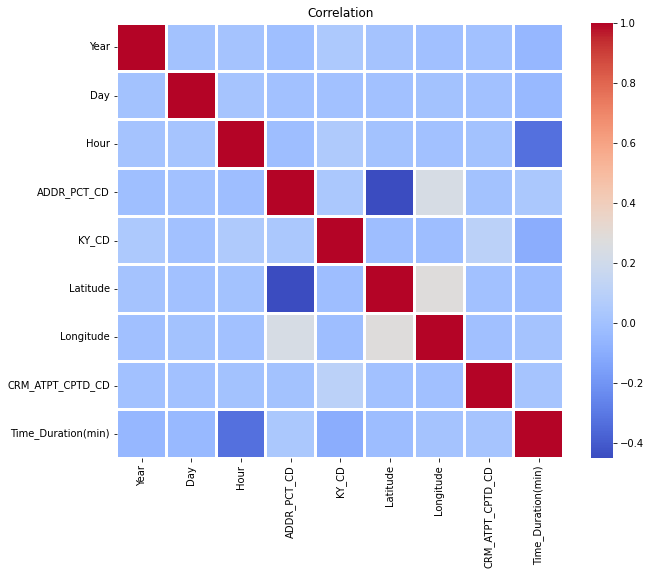

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
df_sel = data[['Year', 'Month', 'Day','Hour','Weekday','LAW_CAT_CD','ADDR_PCT_CD','KY_CD','BORO_NM','Latitude', 'Longitude',
        'VIC_SEX','CRM_ATPT_CPTD_CD', 'SUSP_SEX','OFNS_DESC','Time_Duration(min)']]
corr = df_sel.corr()

plt.figure(figsize = (10,8))
sns.heatmap(corr, cmap = "coolwarm", linewidth = 2, linecolor = "white")
plt.title("Correlation")
plt.show()

# Prediction :

In [ ]:
data.columns 

Index(['Year', 'Month', 'Day', 'Hour', 'Weekday', 'LAW_CAT_CD', 'ADDR_PCT_CD',
       'ADDR_PCT_CD.1', 'KY_CD', 'BORO_NM', 'ADDR_PCT_CD.2', 'ADDR_PCT_CD.3',
       'Latitude', 'Longitude', 'VIC_SEX', 'CRM_ATPT_CPTD_CD', 'SUSP_SEX',
       'OFNS_DESC', 'Time_Duration(min)'],
      dtype='object')

In [ ]:
l =data['OFNS_DESC'].value_counts()

In [ ]:
l['HARRASSMENT 2']

336916

In [ ]:
data['OFNS_DESC'].value_counts()[0:27]

In [2]:
some_values =['HARRASSMENT 2 ' ,'ASSAULT 3 & RELATED OFFENSES'      ,'PETIT LARCENY'   
'OFF. AGNST PUB ORD SENSBLTY &'  ,
'CRIMINAL MISCHIEF & RELATED OF'    ,
'FELONY ASSAULT'                  ,
'GRAND LARCENY'                   ,
'MISCELLANEOUS PENAL LAW'        ,
'ROBBERY'                        ,
'DANGEROUS DRUGS'                ,
'OFFENSES AGAINST PUBLIC ADMINI'   ,
'BURGLARY'                           ,
'DANGEROUS WEAPONS'            ,
'SEX CRIMES'                       ,
'INTOXICATED & IMPAIRED DRIVING'    ,
'FORGERY'                         ,
'VEHICLE AND TRAFFIC LAWS'         ,
'CRIMINAL TRESPASS'                  ,
'RAPE'                               
          ]

In [3]:
data2 = data.loc[data['OFNS_DESC'].isin(some_values)]

In [ ]:
data2

,Year,Month,Day,Hour,Weekday,LAW_CAT_CD,ADDR_PCT_CD,ADDR_PCT_CD.1,KY_CD,BORO_NM,ADDR_PCT_CD.2,ADDR_PCT_CD.3,Latitude,Longitude,VIC_SEX,CRM_ATPT_CPTD_CD,SUSP_SEX,OFNS_DESC,Time_Duration(min)
0,2014.0,Sep,4.0,17,Thu,MISDEMEANOR,81.0,81.0,344.0,BROOKLYN,81.0,81.0,40.685041,-73.921777,F,1,Masculin,ASSAULT 3 & RELATED OFFENSES,10.0
1,2016.0,Oct,12.0,7,Wed,FELONY,121.0,121.0,109.0,STATEN ISLAND,121.0,121.0,40.636991,-74.134093,F,1,Unknown,GRAND LARCENY,5.0
2,2012.0,Sep,28.0,13,Fri,FELONY,41.0,41.0,109.0,BRONX,41.0,41.0,40.823876,-73.891863,F,1,Masculin,GRAND LARCENY,30.0
3,2017.0,May,20.0,4,Sat,MISDEMEANOR,109.0,109.0,344.0,QUEENS,109.0,109.0,40.763992,-73.828426,M,1,Masculin,ASSAULT 3 & RELATED OFFENSES,7.0
5,2007.0,Oct,16.0,2,Tue,FELONY,83.0,83.0,116.0,BROOKLYN,83.0,83.0,40.697964,-73.918083,F,1,Masculin,SEX CRIMES,60.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4294248,2015.0,Dec,5.0,0,Sat,MISDEMEANOR,52.0,52.0,359.0,BRONX,52.0,52.0,40.870793,-73.884649,M,1,Feminen,OFFENSES AGAINST PUBLIC ADMINI,761.0
4294249,2014.0,Mar,2.0,20,Sun,FELONY,41.0,41.0,105.0,BRONX,41.0,41.0,40.816392,-73.895296,M,1,Masculin,ROBBERY,5.0
4294250,2013.0,Mar,13.0,12,Wed,FELONY,61.0,61.0,109.0,BROOKLYN,61.0,61.0,40.583360,-73.951446,F,1,Masculin,GRAND LARCENY,60.0
4294252,2012.0,Dec,20.0,13,Thu,MISDEMEANOR,70.0,70.0,344.0,BROOKLYN,70.0,70.0,40.648648,-73.967731,F,1,Masculin,ASSAULT 3 & RELATED OFFENSES,5.0


In [4]:
data2.drop_duplicates()

,Year,Month,Day,Hour,Weekday,LAW_CAT_CD,ADDR_PCT_CD,ADDR_PCT_CD.1,KY_CD,BORO_NM,ADDR_PCT_CD.2,ADDR_PCT_CD.3,Latitude,Longitude,VIC_SEX,CRM_ATPT_CPTD_CD,SUSP_SEX,OFNS_DESC,Time_Duration(min)
0,2014.0,Sep,4.0,17,Thu,MISDEMEANOR,81.0,81.0,344.0,BROOKLYN,81.0,81.0,40.685041,-73.921777,F,1,Masculin,ASSAULT 3 & RELATED OFFENSES,10.0
1,2016.0,Oct,12.0,7,Wed,FELONY,121.0,121.0,109.0,STATEN ISLAND,121.0,121.0,40.636991,-74.134093,F,1,Unknown,GRAND LARCENY,5.0
2,2012.0,Sep,28.0,13,Fri,FELONY,41.0,41.0,109.0,BRONX,41.0,41.0,40.823876,-73.891863,F,1,Masculin,GRAND LARCENY,30.0
3,2017.0,May,20.0,4,Sat,MISDEMEANOR,109.0,109.0,344.0,QUEENS,109.0,109.0,40.763992,-73.828426,M,1,Masculin,ASSAULT 3 & RELATED OFFENSES,7.0
5,2007.0,Oct,16.0,2,Tue,FELONY,83.0,83.0,116.0,BROOKLYN,83.0,83.0,40.697964,-73.918083,F,1,Masculin,SEX CRIMES,60.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4294248,2015.0,Dec,5.0,0,Sat,MISDEMEANOR,52.0,52.0,359.0,BRONX,52.0,52.0,40.870793,-73.884649,M,1,Feminen,OFFENSES AGAINST PUBLIC ADMINI,761.0
4294249,2014.0,Mar,2.0,20,Sun,FELONY,41.0,41.0,105.0,BRONX,41.0,41.0,40.816392,-73.895296,M,1,Masculin,ROBBERY,5.0
4294250,2013.0,Mar,13.0,12,Wed,FELONY,61.0,61.0,109.0,BROOKLYN,61.0,61.0,40.583360,-73.951446,F,1,Masculin,GRAND LARCENY,60.0
4294252,2012.0,Dec,20.0,13,Thu,MISDEMEANOR,70.0,70.0,344.0,BROOKLYN,70.0,70.0,40.648648,-73.967731,F,1,Masculin,ASSAULT 3 & RELATED OFFENSES,5.0


In [5]:
 features = ['Year',  'Hour', 'Weekday', 'LAW_CAT_CD',
         'BORO_NM',
       'Latitude', 'Longitude', 'VIC_SEX', 'CRM_ATPT_CPTD_CD', 'SUSP_SEX',
       'Time_Duration(min)']
X =  data2[features]
y= data2['OFNS_DESC']

In [6]:
X = pd.get_dummies(X, drop_first=True)

In [18]:
import numpy as np

In [7]:

from numpy import loadtxt
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [8]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

In [ ]:


# fit model no training data
model = XGBClassifier(n_estimators=10, max_depth=5)
model.fit(X_train, y_train)

XGBClassifier(max_depth=5, n_estimators=10, objective='multi:softprob')

In [ ]:
# make predictions for test data
y_pred = model.predict(X_test)


In [ ]:

# evaluate predictions
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy: %.2f%%" % (accuracy))

Accuracy: 0.54%


In [ ]:
import pickle
file_name = "xgb_reg.pkl"

# save
pickle.dump(model, open(file_name, "wb"))



In [10]:
accuracy_lst=[0.5410518636084375]
#accuracy_lst.append(accuracy)
accuracy_lst

[0.5410518636084375]

In [12]:
X_train.shape

(1822986, 23)

In [ ]:
# Import KNeighborsClassifier from sklearn.neighbors
from sklearn.neighbors import KNeighborsClassifier
# Create a k-NN classifier with 3 neighbors
knn = KNeighborsClassifier(n_neighbors=3)

# Fit the classifier to the data
knn.fit(X_train,y_train)

# Predict the labels for the training data X
y_pred = knn.predict(X_test)

# Get the accuracy score
acc_knn=accuracy_score(y_test, y_pred)

# Append to the accuracy list
accuracy_lst.append(acc_knn)

print('[K-Nearest Neighbors (KNN)] knn.score: {:.3f}.'.format(knn.score(X_test, y_test)))
print('[K-Nearest Neighbors (KNN)] accuracy_score: {:.3f}.'.format(acc_knn))

In [11]:
# Random Forest algorithm
from sklearn.ensemble import RandomForestClassifier

#Create a Gaussian Classifier
clf=RandomForestClassifier(n_estimators=10)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,y_train)

y_pred=clf.predict(X_test)


# Get the accuracy score
acc_rf=accuracy_score(y_test, y_pred)

# Append to the accuracy list
accuracy_lst.append(acc_rf)


# Model Accuracy, how often is the classifier correct?
print("[Randon forest algorithm] accuracy_score: {:.3f}.".format(acc_rf))

[Randon forest algorithm] accuracy_score: 0.553.


In [ ]:
import pickle
file_name = "random_forest.pkl"

# save
pickle.dump(clf, open(file_name, "wb"))

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt

No handles with labels found to put in legend.


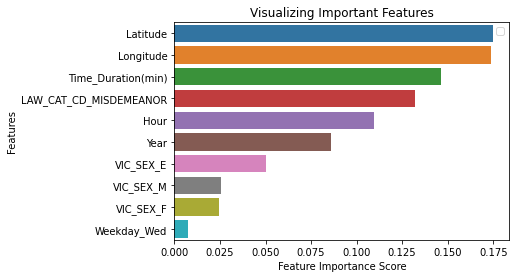

In [13]:
feature_imp = pd.Series(clf.feature_importances_,index=X.columns).sort_values(ascending=False)

# Creating a bar plot, displaying only the top k features
k=10
sns.barplot(x=feature_imp[:10], y=feature_imp.index[:k])
# Add labels to your graph
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title("Visualizing Important Features")
plt.legend()
plt.show()

In [ ]:
# List top k important features
k=20
feature_imp.sort_values(ascending=False)[:k]

Latitude                  0.174750
Longitude                 0.173292
Time_Duration(min)        0.150048
LAW_CAT_CD_MISDEMEANOR    0.114008
Hour                      0.108917
Year                      0.086584
VIC_SEX_E                 0.066022
VIC_SEX_F                 0.027394
VIC_SEX_M                 0.020740
Weekday_Wed               0.007763
Weekday_Thu               0.007698
Weekday_Tue               0.007392
Weekday_Mon               0.007199
Weekday_Sat               0.007076
BORO_NM_MANHATTAN         0.007014
SUSP_SEX_Unknown          0.006657
SUSP_SEX_Masculin         0.006566
Weekday_Sun               0.006255
CRM_ATPT_CPTD_CD          0.004461
BORO_NM_QUEENS            0.003523
dtype: float64

In [14]:
# Create a selector object that will use the random forest classifier to identify
# features that have an importance of more than 0.03
from sklearn.feature_selection import SelectFromModel

sfm = SelectFromModel(clf, threshold=0.03)

# Train the selector
sfm.fit(X_train, y_train)

feat_labels=X.columns

# Print the names of the most important features
for feature_list_index in sfm.get_support(indices=True):
    print(feat_labels[feature_list_index])

Year
Hour
Latitude
Longitude
Time_Duration(min)
LAW_CAT_CD_MISDEMEANOR
VIC_SEX_E


In [15]:
# Transform the data to create a new dataset containing only the most important features
# Note: We have to apply the transform to both the training X and test X data.
X_important_train = sfm.transform(X_train)
X_important_test = sfm.transform(X_test)

# Create a new random forest classifier for the most important features
clf_important = RandomForestClassifier(n_estimators=5, random_state=0, n_jobs=-1)

# Train the new classifier on the new dataset containing the most important features
clf_important.fit(X_important_train, y_train)

RandomForestClassifier(n_estimators=5, n_jobs=-1, random_state=0)

In [16]:
# Apply The Full Featured Classifier To The Test Data
y_pred = clf.predict(X_test)

# View The Accuracy Of Our Full Feature Model
print('[Randon forest algorithm -- Full feature] accuracy_score: {:.3f}.'.format(accuracy_score(y_test, y_pred)))

# Apply The Full Featured Classifier To The Test Data
y_important_pred = clf_important.predict(X_important_test)

# View The Accuracy Of Our Limited Feature Model
print('[Randon forest algorithm -- Limited feature] accuracy_score: {:.3f}.'.format(accuracy_score(y_test, y_important_pred)))
acc_rfl = accuracy_score(y_test, y_important_pred)
accuracy_lst.append(acc_rfl)

[Randon forest algorithm -- Full feature] accuracy_score: 0.553.
[Randon forest algorithm -- Limited feature] accuracy_score: 0.493.


In [17]:
accuracy_lst = [0.4410518636084375,0.5410518636084375, 0.49317018226500103,  0.5527506143764079]

In [18]:
algo_lst=[' K-Nearest Neighbors','Random Forest','Random Forest Limited', 'XGBoost']

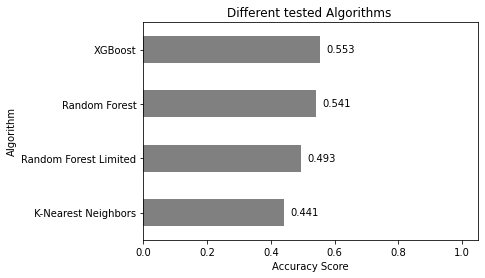

In [20]:
# Make a plot of the accuracy scores for different algorithms
import numpy as np
import matplotlib.pyplot as plt

# Generate a list of ticks for y-axis
y_ticks=np.arange(len(algo_lst))

# Combine the list of algorithms and list of accuracy scores into a dataframe, sort the value based on accuracy score
df_acc=pd.DataFrame(list(zip(algo_lst, accuracy_lst)), columns=['Algorithm','Accuracy_Score']).sort_values(by=['Accuracy_Score'],ascending = True)

# Export to a file
#df_acc.to_csv('./Accuracy_scores_algorithms_{}.csv'.format(state),index=False)

# Make a plot
ax=df_acc.plot.barh('Algorithm', 'Accuracy_Score', align='center',legend=False,color='0.5')

# Add the data label on to the plot
for i in ax.patches:
    # get_width pulls left or right; get_y pushes up or down
    ax.text(i.get_width()+0.02, i.get_y()+0.2, str(round(i.get_width(),3)), fontsize=10)

# Set the limit, lables, ticks and title
plt.xlim(0,1.05)
plt.xlabel('Accuracy Score')
plt.yticks(y_ticks, df_acc['Algorithm'], rotation=0)
plt.title('Different tested Algorithms ')

plt.show()